In [1]:
from typing import Tuple, List, Dict, Union
import os
from pathlib import Path
import glob
import gc
from datetime import datetime

from PIL import Image
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import geojson
from patchify import patchify
import cv2

OPENSLIDE_PATH  = r'C:/openslide/openslide-win64/bin'
if hasattr(os, 'add_dll_directory'):
    # Python >= 3.8 on Windows
    with os.add_dll_directory(OPENSLIDE_PATH):
        import openslide
else:
    import openslide

In [2]:
DATA_PATH = '/mnt/d/UCL-HDS-DissertationDataset/BRACS/BRACS_WSI'
ANNOT_PATH = '/mnt/d/UCL-HDS-DissertationDataset/BRACS_WSI_Annotations'
PATCH_PATH = './data/patches'

In [3]:
def get_bbox_by_coordinates(coordinates: List, shape_type: str) -> Tuple[np.ndarray, np.ndarray]:
    """
    Given a list of coordinates, return the bounding box

    returns: (x_min, y_min), (x_max, y_max)
    """

    coordinates_arr = np.array([])
    if shape_type == 'Polygon':
        # first coordinate is the outer polygon, the rest are holes
        coordinates_arr = np.array(coordinates[0]).squeeze()
    elif shape_type == 'MultiPolygon':
        for polygon in coordinates:
            coordinates_arr = np.array(polygon[0]).squeeze()
            if coordinates_arr.shape[0] > 4:
                break
    else:
        raise ValueError(f'Unknown shape type: {shape_type}')
    
    coord_min = np.floor(np.min(coordinates_arr, axis=0)).astype(int)
    coord_max = np.ceil(np.max(coordinates_arr, axis=0)).astype(int)
    return tuple(coord_min), tuple(coord_max)

In [4]:
def create_bbox_list(annotations: Dict) -> List[Dict]:
    """
    Given a dictionary of annotations, return a list of bounding boxes and their classifications

    returns: list of bounding boxes and their classifications
    """
    bboxes = []
    for annotation in annotations['features']:
        bboxes.append({
            "classification": annotation['properties']['classification']["name"],
            "coordinates": get_bbox_by_coordinates(
                annotation['geometry']['coordinates'],
                annotation['geometry']['type']
            )
        })
    return bboxes

In [5]:
def get_annotated_rois(slide: openslide.OpenSlide, bboxes: List[Dict]) -> List[Dict]:
    """
    Given a list of bounding boxes, return a list of ROI images and their classifications

    returns: list of ROI images and their classifications
    """
    rois = []
    for bbox in bboxes:
        min_coord, max_coord = bbox["coordinates"][0], bbox["coordinates"][1]
        roi = slide.read_region(
            min_coord,
            level=0,
            size=tuple(np.subtract(max_coord, min_coord))
        ).convert('RGB')
        rois.append({
            "class":bbox["classification"],
            "image": roi
        })
    return rois

In [6]:
def display_rois(rois: List[Dict]):
    """
    Given a list of ROIs, display them
    """
    num_of_rois = len(rois)
    print(f'total number of ROIs: {num_of_rois}')
    plt.figure(figsize=(15, int(np.ceil(num_of_rois))))
    for num, roi in enumerate(rois):
        plt.subplot(int(np.ceil(num_of_rois/3)), 3, num+1)
        plt.imshow(np.array(roi["image"]))
        plt.title(roi["class"])
        plt.axis('off')

    plt.tight_layout()
    plt.show()

In [7]:
def get_relative_coordinates(coordinates: np.ndarray, min_coord: Tuple) -> np.ndarray:
    """
    Given a list of coordinates, return the relative coordinates

    returns: list of relative coordinates
    """
    return np.subtract(coordinates, min_coord)

In [8]:
def create_masks(annotations: Dict) -> List[np.ndarray]:
    """
    Given a dictionary of annotations, return a list of masks of each ROI

    returns: masks of each ROI
    """
    masks = []

    for annotation in annotations['features']:
        coordinates = annotation['geometry']['coordinates']
        min_coord, max_coord = get_bbox_by_coordinates(coordinates, annotation['geometry']['type'])
        height, width = np.subtract(max_coord, min_coord)[::-1]
        mask = np.zeros((height, width), dtype=np.int32)

        # create blank mask if type is not polygon
        if annotation['geometry']['type'] == 'Polygon':
        # first list of coordinate is the outer polygon, the rest are holes
            coordinates_arr = np.array(coordinates[0]).squeeze()
            relative_coordinates = get_relative_coordinates(coordinates_arr, min_coord)
            mask = cv2.fillPoly(mask, pts=np.array([relative_coordinates], dtype=np.int32), color=(255, 255, 255))
        elif annotation['geometry']['type'] == 'MultiPolygon':
            # loop through each polygon, stop at the first polygon with more than 4 coordinates
            for polygon in coordinates:
                # first list of coordinate is the outer polygon, the rest are holes
                coordinates_arr = np.array(polygon[0]).squeeze()
                # take only polygon with more than 4 coordinates
                if coordinates_arr.shape[0] > 4:
                    relative_coordinates = get_relative_coordinates(coordinates_arr, min_coord)
                    mask = cv2.fillPoly(mask, pts=np.array([relative_coordinates], dtype=np.int32), color=(255, 255, 255))
                    break
        
        masks.append(mask)
    return masks

In [9]:
def display_patch(patch: np.ndarray, mask_patch: Union[np.ndarray, None] = None, is_overlay: bool = False):
    plt.imshow(patch, vmin=0, vmax=255)
    if is_overlay:
        masked_arr = np.ma.masked_where(mask_patch == 0, mask_patch)
        plt.imshow(masked_arr, alpha=0.5)
    plt.axis('off')

def display_patches(patches: np.ndarray, mask_patches: Union[np.ndarray, List] = [], is_mask: bool = False, is_overlay: bool = False):
    """
    Given a list of ROIs, display them
    """
    num_of_patches = patches.shape[0] * patches.shape[1]
    print(f'total number of patches: {num_of_patches}')
    plt.figure(figsize=(15, 10))
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            patch = patches[i, j, 0]
            plt.subplot(patches.shape[0], patches.shape[1], i*patches.shape[1] + j + 1)
            if is_mask:
                patch = np.ma.masked_where(patches[i, j] == 0, patches[i, j])
            # set vmin and vmax to 0 and 255 to display the mask
            if is_overlay:
                mask_patch = mask_patches[i, j]
                display_patch(patch, mask_patch=mask_patch, is_overlay=True)
            else:
                display_patch(patch)
    plt.tight_layout()
    plt.show()

In [10]:
def resize_roi_and_masks(roi_arr: np.ndarray, mask: np.ndarray, downsample_factor: int = 2):
    """
    Given a ROI and its mask, resize them by the downsample factor
    """
    roi_arr = np.array(roi_arr, dtype=np.uint8)
    mask = mask.astype(np.uint8)

    # downsample the roi_arr and mask, W and H are reversed for cv2.resize
    roi_arr = cv2.resize(roi_arr, (roi_arr.shape[1]//downsample_factor, roi_arr.shape[0]//downsample_factor))
    mask = cv2.resize(mask, (mask.shape[1]//downsample_factor, mask.shape[0]//downsample_factor))

    return roi_arr, mask

In [11]:
def save_patches(patches: np.ndarray, mask_patches: np.ndarray, save_path: str = '', verbose: bool = False):
    """
    Save patches to a given path
    """
    num_of_patches = patches.shape[0] * patches.shape[1]
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            # save patch
            patch = patches[i, j, 0]
            patch = Image.fromarray(patch)
            os.makedirs(f'{save_path}/patch', exist_ok=True)
            patch.save(f'{save_path}/patch/{i}_{j}.png')

            # save mask
            mask = mask_patches[i, j]
            mask = Image.fromarray(np.stack((mask,)*3, axis=-1).astype(np.uint8))
            
            os.makedirs(f'{save_path}/mask', exist_ok=True)
            mask.save(f'{save_path}/mask/{i}_{j}.png')

    if verbose:
        print(f'saved {num_of_patches} patches')

In [12]:
def patchify_and_save(roi_arr: np.ndarray, mask: np.ndarray, save_path: str = '', overlap: bool = True, verbose: bool = False):
    assert roi_arr.shape[0] == mask.shape[0] and roi_arr.shape[1] == mask.shape[1], "ROI and mask must have the same shape"
    min_dim = min(roi_arr.shape[0], roi_arr.shape[1], 512)
    step = min_dim//2 if overlap else min_dim
    roi_patches = patchify(roi_arr, (min_dim, min_dim, 3), step=step)
    mask_patches = patchify(mask, (min_dim, min_dim), step=step)
    save_patches(roi_patches, mask_patches, save_path=save_path, verbose=verbose)

levels: 4
level dimensions ((147408, 88478), (36852, 22119), (9213, 5529), (2303, 1382))
level downsamples (1.0, 4.000045210000453, 16.001266051727256, 64.01432756493921)


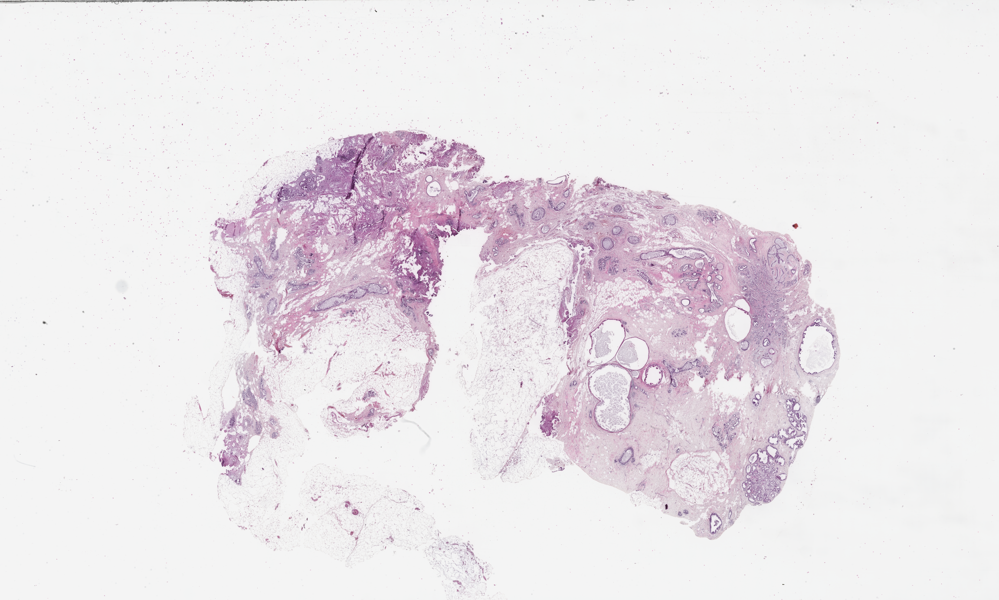

In [13]:
slide = openslide.OpenSlide(f'{DATA_PATH}/train/Group_AT/Type_ADH/BRACS_1486.svs')

print("levels:", slide.level_count)
print("level dimensions", slide.level_dimensions)
print("level downsamples", slide.level_downsamples)

# get annotations
annotation_file = f'{ANNOT_PATH}/train/Group_AT/Type_ADH/BRACS_1486.geojson'
annotations = geojson.load(open(annotation_file))
bbox_list = create_bbox_list(annotations)
rois = get_annotated_rois(slide, bbox_list)
masks = create_masks(annotations)

# display lowest resolution
slide.get_thumbnail(slide.level_dimensions[-1])

total number of ROIs: 13


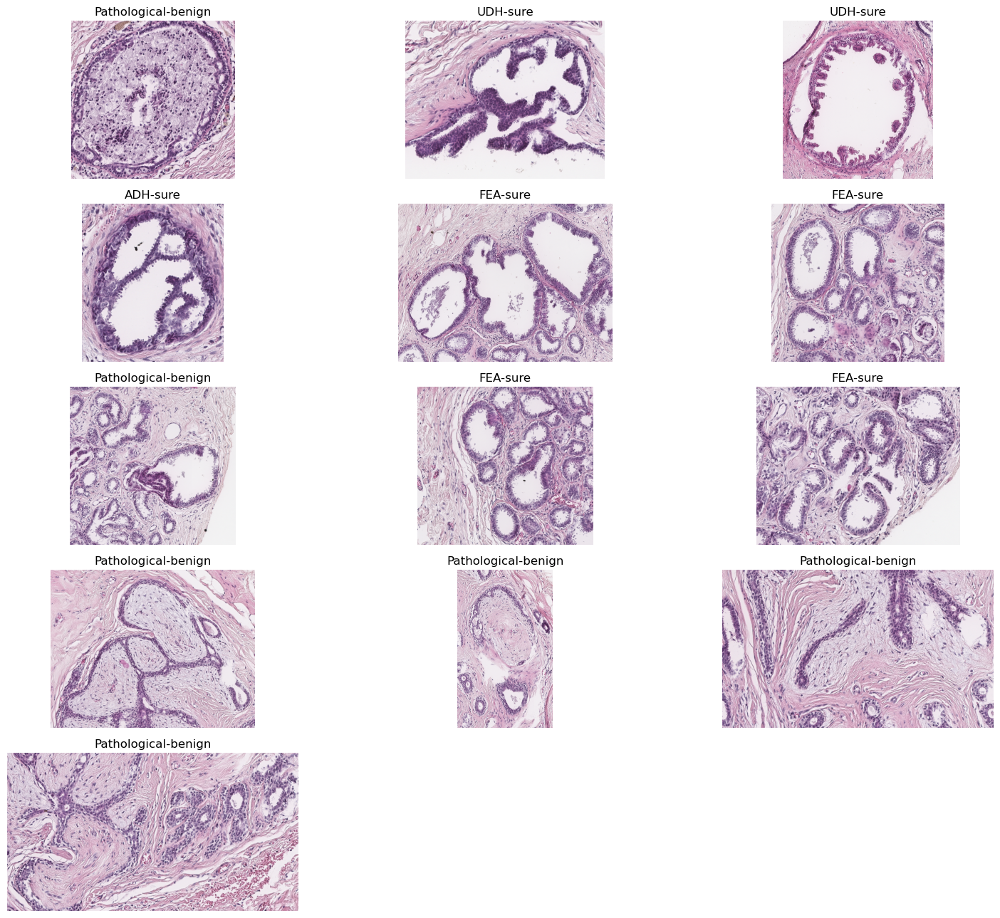

In [14]:
display_rois(rois)

In [15]:
for idx, (roi, mask) in enumerate(zip(rois, masks)):
    # sample 40x and 20x patches
    patchify_and_save(np.array(roi["image"]), mask, save_path=f'{PATCH_PATH}/train_sample/BRACS_1486/{roi["class"]}-{idx}-40x', overlap=False)

    roi_arr, mask = resize_roi_and_masks(np.array(roi["image"]), mask, downsample_factor=2)
    patchify_and_save(roi_arr, mask, save_path=f'{PATCH_PATH}/train_sample/BRACS_1486/{roi["class"]}-{idx}-20x', overlap=False)

./data/patches/train_sample/BRACS_1486/ADH-sure-3-20x
total number of patches: 1


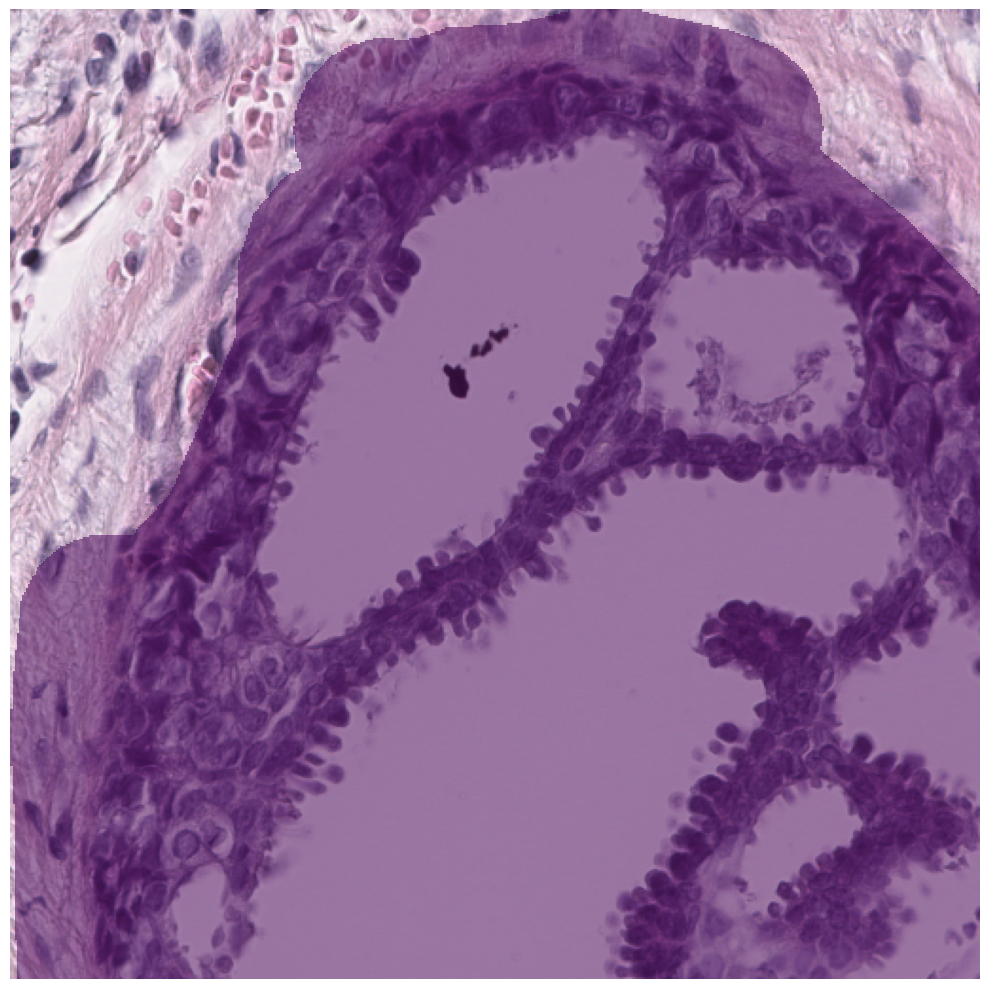

./data/patches/train_sample/BRACS_1486/ADH-sure-3-40x
total number of patches: 4


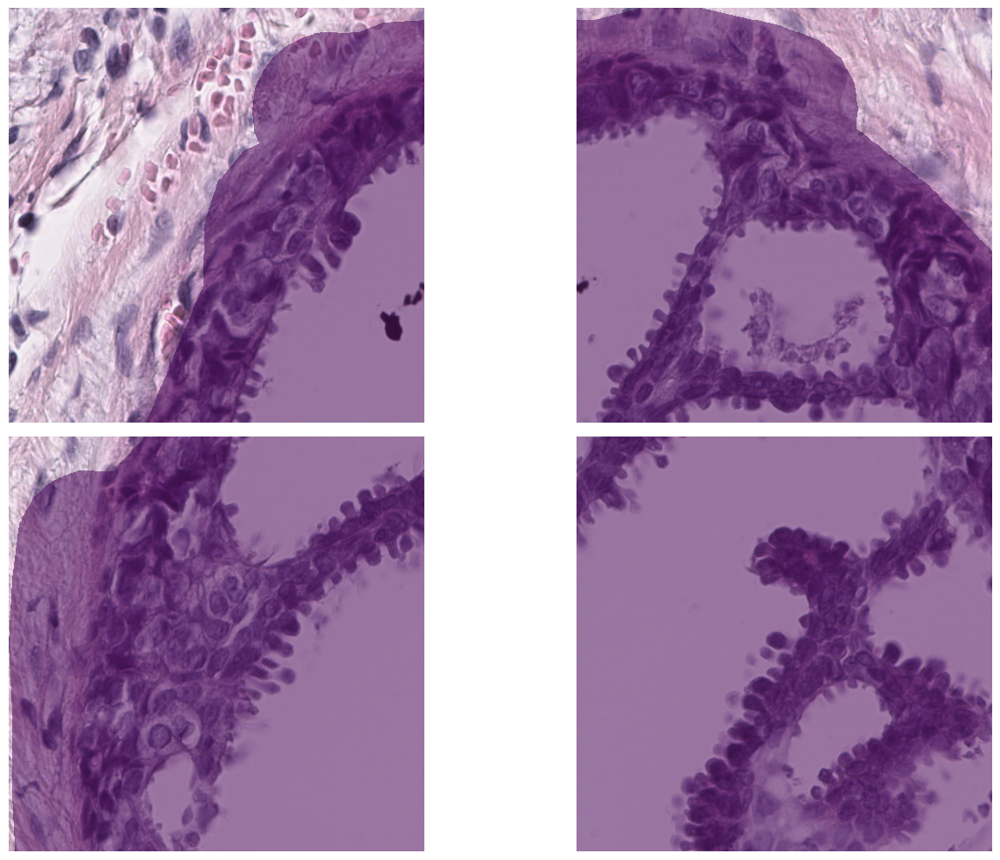

In [16]:
for sample_patch_folder_path in sorted(glob.glob(f'{PATCH_PATH}/train_sample/BRACS_1486/*'))[0:2]:
    print(sample_patch_folder_path)
    patch_paths = sorted(glob.glob(f'{sample_patch_folder_path}/patch/*'))
    mask_paths = sorted(glob.glob(f'{sample_patch_folder_path}/mask/*'))

    patches = []
    for patch_path in patch_paths:
        patch = cv2.imread(patch_path)
        patch = cv2.cvtColor(patch, cv2.COLOR_BGR2RGB)
        patches.append(patch)
    patches = np.array(patches)

    mask_patches = []
    for mask_path in mask_paths:
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) > 0.5
        mask_patches.append(mask)
    mask_patches = np.array(mask_patches)

    # reshape patches and mask_patches to (vertical position, horizontal position, H, W, C)
    vertical_patch_idx, horizontal_patch_idx = patch_paths[-1].split('/')[-1].split('.')[0].split('_')
    vertical_patch_count, horizontal_patch_count = int(vertical_patch_idx) + 1, int(horizontal_patch_idx) + 1
    patches = patches.reshape((vertical_patch_count, horizontal_patch_count, patches.shape[1], patches.shape[2], patches.shape[3]))
    mask_patches = mask_patches.reshape((vertical_patch_count, horizontal_patch_count, mask_patches.shape[1], mask_patches.shape[2]))

    display_patches(patches, mask_patches, is_mask=True, is_overlay=True)

levels: 4
level dimensions ((129480, 88553), (32370, 22138), (8092, 5534), (4046, 2767))
level downsamples (1.0, 4.000022585599422, 16.00130747041477, 32.00261494082954)


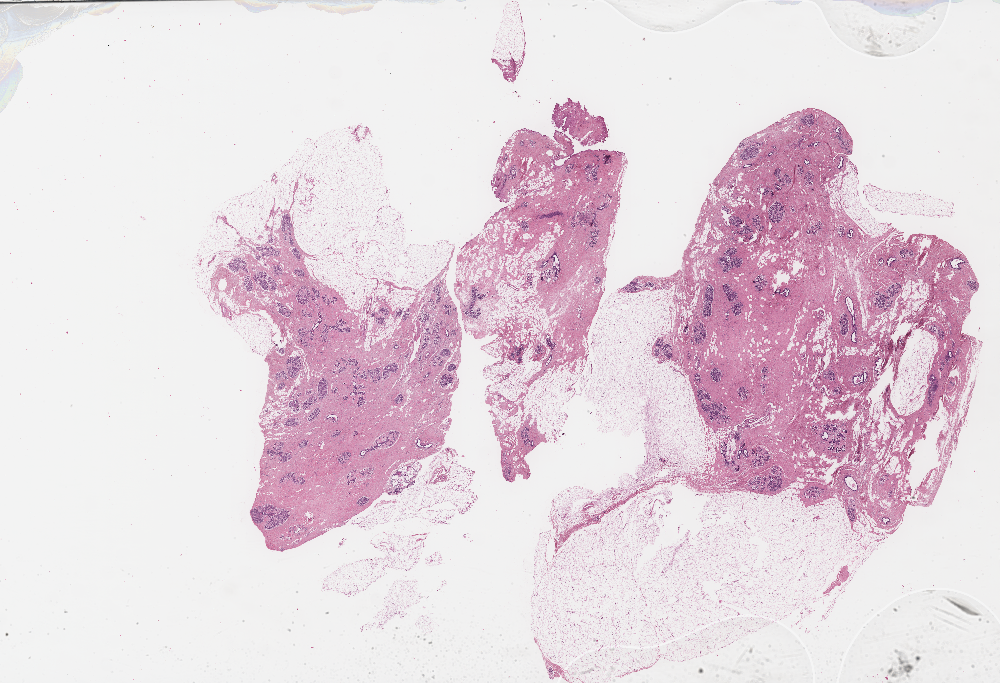

In [17]:
slide = openslide.OpenSlide(f'{DATA_PATH}/train/Group_BT/Type_PB/BRACS_745.svs')
slide.read_region((256, 256), 3, (256, 256))

print("levels:", slide.level_count)
print("level dimensions", slide.level_dimensions)
print("level downsamples", slide.level_downsamples)

# get annotations
annotation_file = f'{ANNOT_PATH}/train/Group_BT/Type_PB/BRACS_745.geojson'
annotations = geojson.load(open(annotation_file))
bbox_list = create_bbox_list(annotations)
rois = get_annotated_rois(slide, bbox_list)
masks = create_masks(annotations)

# display lowest resolution
slide.get_thumbnail(slide.level_dimensions[-1])

total number of ROIs: 22


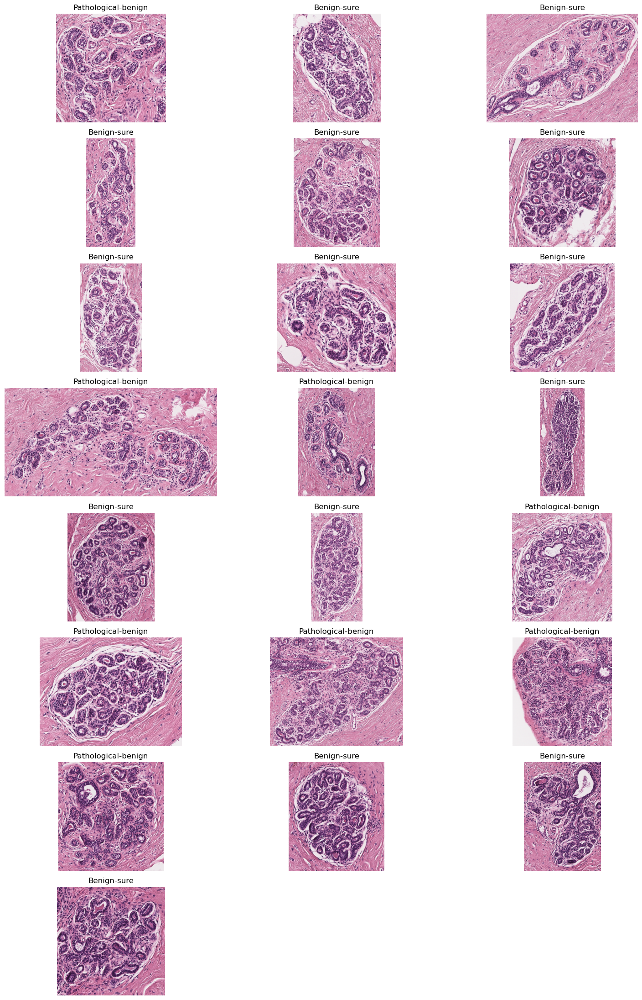

In [18]:
display_rois(rois)

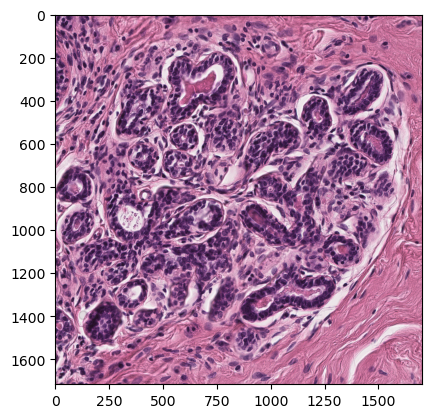

In [19]:
for idx, (roi, mask) in enumerate(zip(rois, masks)):
    roi_arr, mask = resize_roi_and_masks(roi["image"], mask, downsample_factor=2)
    plt.imshow(roi["image"])

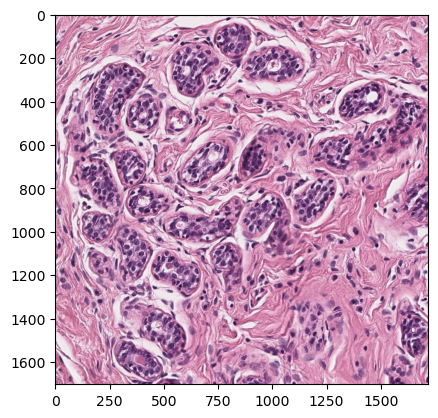

In [20]:
roi_image_arr = np.array(rois[0]["image"])

plt.imshow(roi_image_arr)

total number of patches: 9


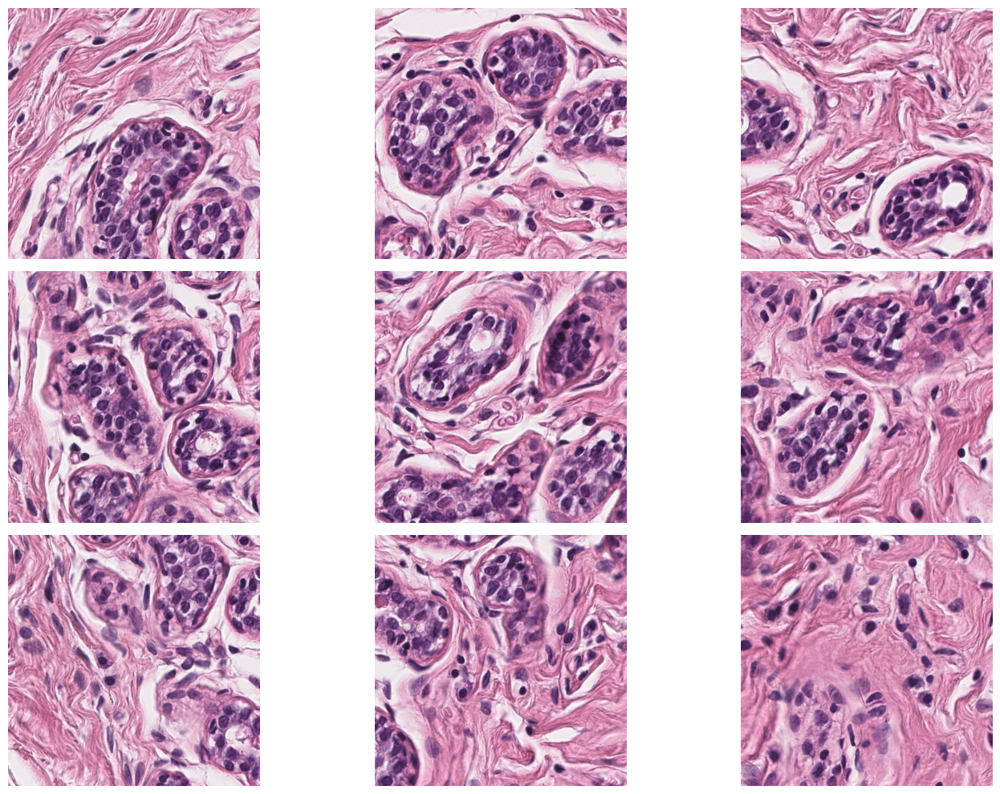

In [21]:
sample_patches = patchify(roi_image_arr, (512, 512, 3), step=512)
display_patches(sample_patches)

total number of patches: 9


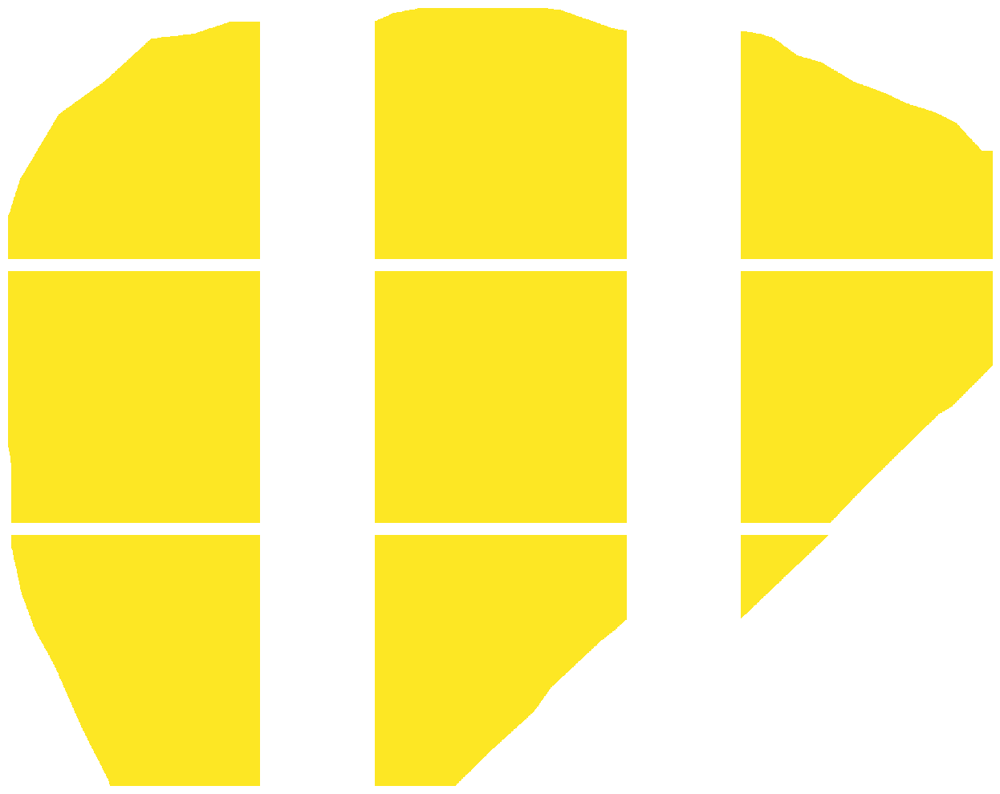

In [22]:
sample_mask_patches = patchify(masks[0], (512, 512), step=512)
display_patches(sample_mask_patches, is_mask=True)

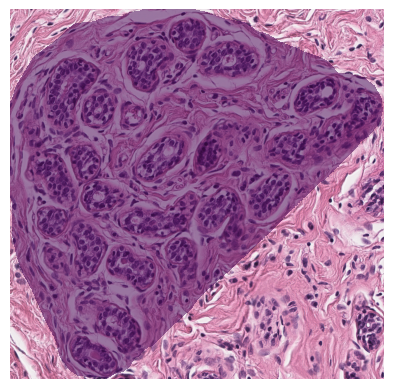

In [23]:
display_patch(roi_image_arr, mask_patch=masks[0], is_overlay=True)

total number of patches: 9


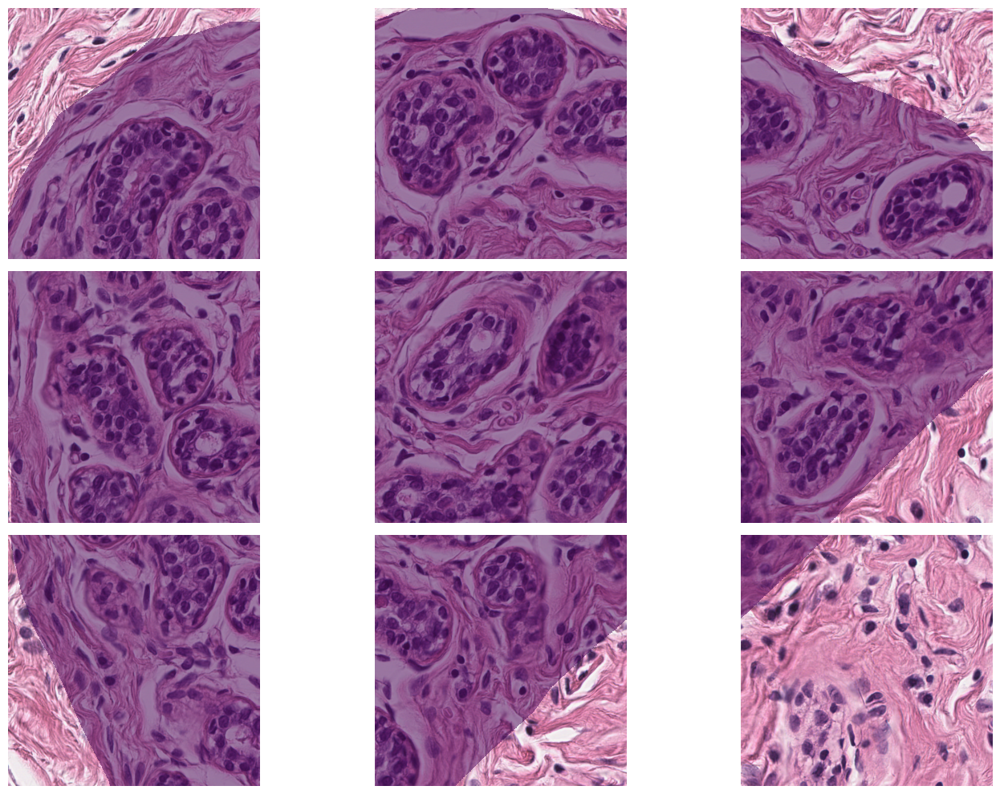

In [24]:
display_patches(sample_patches, mask_patches=sample_mask_patches, is_overlay=True)

In [25]:
gc.collect()

36324

In [26]:
# get all annotations
train_set = glob.glob(f'{ANNOT_PATH}/train/**/*.geojson', recursive=True)
val_set = glob.glob(f'{ANNOT_PATH}/val/**/*.geojson', recursive=True)
test_set = glob.glob(f'{ANNOT_PATH}/test/**/*.geojson', recursive=True)

In [27]:
failed_file_path = Path(f'./logs/failed_preprocess_files-{datetime.now().strftime("%Y%m%d-%H%M%S")}.txt')
for train_annot_path in train_set:
    file_id = train_annot_path.split('/')[-1].split('.')[0]

    # create if not exists
    if not f'{PATCH_PATH}/train/{file_id}' in glob.glob(f'{PATCH_PATH}/train/{file_id}'):
        print('processing:', file_id)
        wsi_file_paths = glob.glob(f'{DATA_PATH}/train/**/{file_id}.svs', recursive=True)

        if len(wsi_file_paths) != 0:
            try:
                slide = openslide.OpenSlide(wsi_file_paths[0])
                annotations = geojson.load(open(train_annot_path))
                bbox_list = create_bbox_list(annotations)
                rois = get_annotated_rois(slide, bbox_list)
                masks = create_masks(annotations)

                for idx, (roi, mask) in enumerate(zip(rois, masks)):
                    roi_arr = np.array(roi["image"])
                    patchify_and_save(roi_arr, mask, save_path=f'{PATCH_PATH}/train/{file_id}/{roi["class"]}-{idx}-40x', overlap=False)

                    roi_arr, mask = resize_roi_and_masks(roi["image"], mask, downsample_factor=2)
                    patchify_and_save(roi_arr, mask, save_path=f'{PATCH_PATH}/train/{file_id}/{roi["class"]}-{idx}-20x', overlap=False)

                slide.close()
            except Exception as e:
                print(f'fail to process {file_id}:', e)
                # write failed WSI file id to a file, create if not exists
                failed_file_path.parent.mkdir(parents=True, exist_ok=True)
                with open(failed_file_path, 'a+') as f:
                    f.write(f'{file_id}\n')

        gc.collect()
    else:
        print(f'{PATCH_PATH}/train/{file_id} already exists')

./data/patches/train/BRACS_1003728 already exists
./data/patches/train/BRACS_1486 already exists
./data/patches/train/BRACS_1494 already exists
./data/patches/train/BRACS_1499 already exists
./data/patches/train/BRACS_1616 already exists
./data/patches/train/BRACS_1622 already exists
./data/patches/train/BRACS_1794 already exists
./data/patches/train/BRACS_1795 already exists
./data/patches/train/BRACS_1808 already exists
./data/patches/train/BRACS_1860 already exists
./data/patches/train/BRACS_1861 already exists
./data/patches/train/BRACS_1863 already exists
./data/patches/train/BRACS_1877 already exists
./data/patches/train/BRACS_1882 already exists
./data/patches/train/BRACS_1899 already exists
./data/patches/train/BRACS_1911 already exists
./data/patches/train/BRACS_1912 already exists
./data/patches/train/BRACS_1913 already exists
./data/patches/train/BRACS_1915 already exists
./data/patches/train/BRACS_1922 already exists
./data/patches/train/BRACS_1925 already exists
./data/pat

In [28]:
gc.collect()

0

In [29]:
for val_annot_path in val_set:
    file_id = val_annot_path.split('/')[-1].split('.')[0]

    # create if not exists
    if not f'{PATCH_PATH}/val/{file_id}' in glob.glob(f'{PATCH_PATH}/val/{file_id}'):
        print('processing:', file_id)
        wsi_file_paths = glob.glob(f'{DATA_PATH}/val/**/{file_id}.svs', recursive=True)

        if len(wsi_file_paths) != 0:
            try:
                slide = openslide.OpenSlide(wsi_file_paths[0])
                annotations = geojson.load(open(val_annot_path))
                bbox_list = create_bbox_list(annotations)
                rois = get_annotated_rois(slide, bbox_list)
                masks = create_masks(annotations)

                for idx, (roi, mask) in enumerate(zip(rois, masks)):
                    roi_arr = np.array(roi["image"])
                    patchify_and_save(roi_arr, mask, save_path=f'{PATCH_PATH}/val/{file_id}/{roi["class"]}-{idx}-40x', overlap=False)

                    roi_arr, mask = resize_roi_and_masks(roi["image"], mask, downsample_factor=2)
                    patchify_and_save(roi_arr, mask, save_path=f'{PATCH_PATH}/val/{file_id}/{roi["class"]}-{idx}-20x', overlap=False)

                slide.close()
            except Exception as e:
                print(f'fail to process {file_id}:', e)
                # write failed WSI file id to a file, create if not exists
                failed_file_path.parent.mkdir(parents=True, exist_ok=True)
                with open(failed_file_path, 'a+') as f:
                    f.write(f'{file_id}\n')

        gc.collect()
    else:
        print(f'{PATCH_PATH}/val/{file_id} already exists')

processing: BRACS_1271
processing: BRACS_1797
processing: BRACS_1876
processing: BRACS_1885
processing: BRACS_1953
processing: BRACS_1610
processing: BRACS_1886
processing: BRACS_1296
processing: BRACS_1584
processing: BRACS_1585
processing: BRACS_1608
processing: BRACS_1003660
processing: BRACS_1003661
processing: BRACS_1295
processing: BRACS_1591
processing: BRACS_1592
processing: BRACS_1595
processing: BRACS_1609
processing: BRACS_265
processing: BRACS_1366
processing: BRACS_1367
processing: BRACS_1607
processing: BRACS_1883
processing: BRACS_1935
processing: BRACS_735
processing: BRACS_736
processing: BRACS_737
processing: BRACS_1361
processing: BRACS_1362
processing: BRACS_1368
processing: BRACS_1392
processing: BRACS_1394
processing: BRACS_1395
processing: BRACS_1798
processing: BRACS_738
processing: BRACS_739
processing: BRACS_740


In [30]:
gc.collect()

0